## The crimes happened in Philadelphia from 2006 to 2017

Questions:

1.What is the trend of crime frequncy in these years ? Increased or decreased ?

2.What are the most serious crime ? Which crime has the highest frequency of occurrence?

3.Is there any relationship between a certain kind of criminal activity and geographical position?

4.Will a type of crime in a particular area be particularly high?

5.What are the criminal behavior distribution like based on DC_District and Police_District ?

6.What are the difference of crime  frequency between day and night?


【Attention】:

Because the dataset is too huge, if you cannot process the code or show the graphs and maps. 
Please put the following code in the cmd.exe to resolve that: 
jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
from mpl_toolkits.basemap import Basemap
from IPython.display import HTML
from matplotlib.ticker import FuncFormatter
from pylab import rcParams
from matplotlib import animation
from matplotlib.animation import FuncAnimation
%matplotlib inline

import datetime

import warnings
warnings.filterwarnings("ignore")
import seaborn as sns
sns.set(style="white", color_codes=True)

In [2]:
Data = pd.read_csv('C:/Anaconda/Scripts/my-jupyter/data/crime.csv')

In [3]:
#Change the date format, sort the data by time (this will be used in the last short vedio)
#Add new columns as below.

Dat = pd.to_datetime(Data.Dispatch_Date_Time)
Data.Dispatch_Date_Time = Dat
Data.sort_values(by='Dispatch_Date_Time', inplace=True)
Data.index = np.array(range(Data.shape[0]))
Dat = pd.to_datetime(Data.Dispatch_Date_Time)
Data['all_hour'] = abs(Dat - Dat[0]).dt.total_seconds() / 3600.0
Data['month'] = Dat.dt.month
Data['year'] = Dat.dt.year
Data['day'] = Dat.dt.day
Data['x'] = 1
Data['y'] = 1

## The different frequency of different crime behaviours

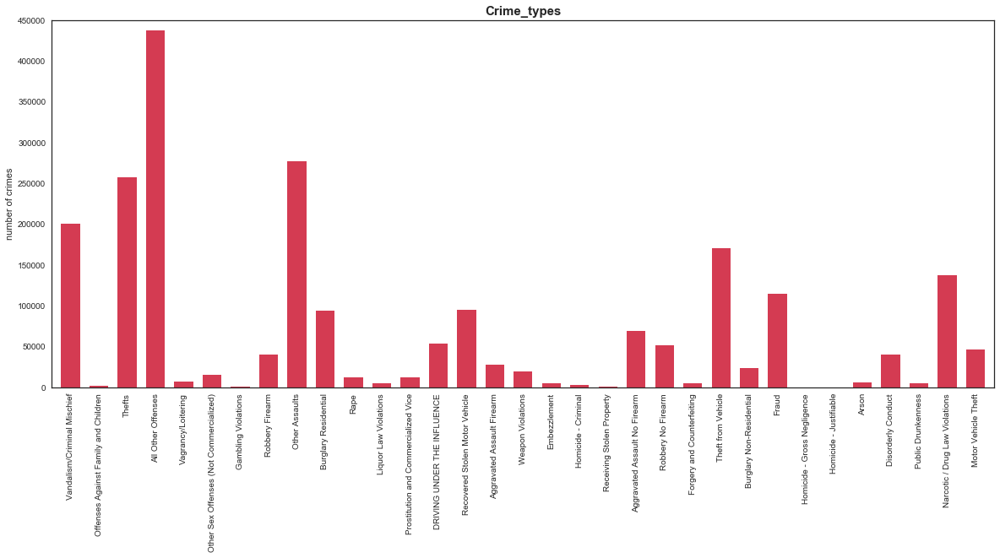

In [4]:
rcParams['figure.figsize'] = 20,8

crimes = np.array( Data.Text_General_Code.value_counts(sort= False))
Crime_Counts = crimes.shape[0]

ind = np.arange(Crime_Counts)*1.2+0.8    
p1 = plt.bar(ind, crimes, width=0.8, color= [0.833,0.233,0.320])
plt.ylabel('number of crimes')
plt.xticks(ind, Data.Text_General_Code.value_counts(sort= False).index, rotation =90)
plt.title('Crime_types',fontsize=15, fontweight="bold")
plt.axis([0,40, 0.0, 450000])

plt.show()

From this graph ,we can see The different frequency of different crime behaviours and pick up the main crimes.

## The totale amounts of all crimes happened in each day and each month

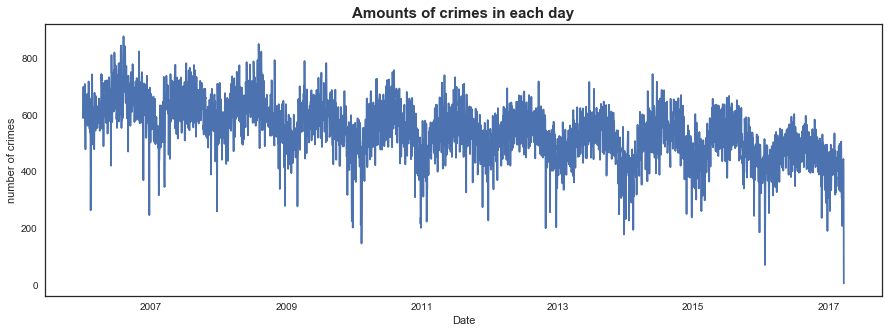

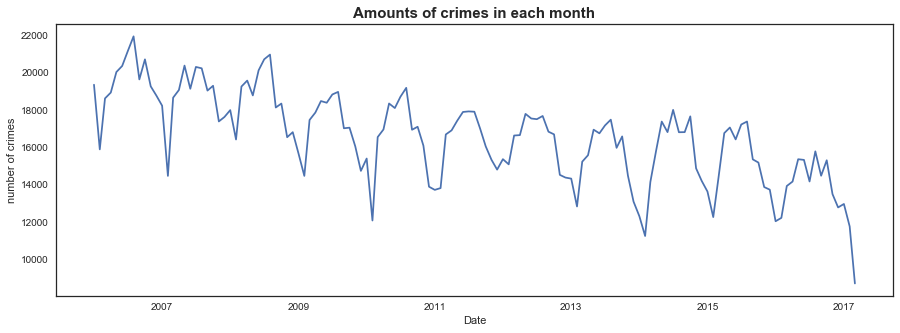

In [5]:
Data['month'] = Dat.dt.month
Data['year'] = Dat.dt.year
Data['day'] = Dat.dt.day
Group = Data.groupby(['year', 'month', 'day'])['day'].count()
Count = Group.to_frame(name='count').reset_index()
fig, ax = plt.subplots(figsize=(15,5))
ax.plot_date(Data.Dispatch_Date.unique(), Count['count'], '-')
ax.set_ylabel('number of crimes')
ax.set_xlabel('Date')
ax.set_title('Amounts of crimes in each day',fontsize=15, fontweight="bold")

Data['month'] = Dat.dt.month
Data['year'] = Dat.dt.year
Group = Data.groupby(['year', 'month'])['month'].count()
Count = Group.to_frame(name='count').reset_index()
fig, ax = plt.subplots(figsize=(15,5))
ax.plot_date(Data.Month.unique(), Count['count'], '-')
ax.set_ylabel('number of crimes')
ax.set_xlabel('Date')
ax.set_title('Amounts of crimes in each month',fontsize=15, fontweight="bold")

The total number of crimes declines year by year, but there is a cycle of crime frequency in each year.
Most crimes occurred in mid-year and less in winter.

## The change of different crimes frequency based on years

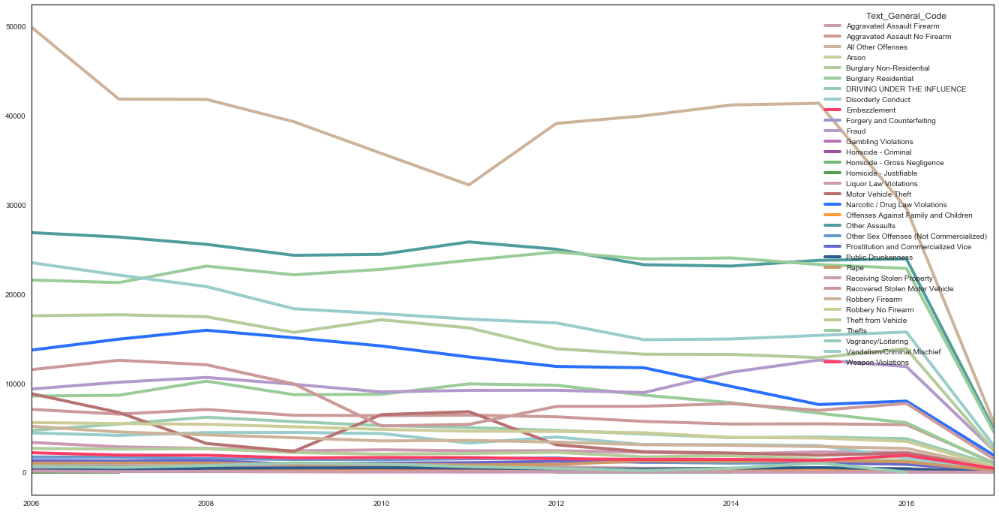

In [6]:
Crime_types = Data.groupby(['year','Text_General_Code'])['x','y'].sum()

plot_Crimetypes = Crime_types.unstack('Text_General_Code').loc[:, 'x']
plot_Crimetypes.index = pd.PeriodIndex(plot_Crimetypes.index.tolist(), freq='A')

plot_Crimetypes.plot(figsize=(23,12), linewidth=4, 
                      color=['#CC99B3', '#CC9999', '#CCB399', '#CCCC99', '#B3CC99','#99CC99', 
                             '#99CCB3', '#99CCCC', '#FF3D64', '#9999CC','#B399CC', '#B771B7', 
                             '#9C4F9C', '#71B771', '#4F9C4F','#CC99B3', '#B77171', '#2970FF', 
                             '#FF9933', '#4F9C9C','#6699CC', '#6666CC', '#2E5C8A', '#CC9966'])

we can see all the crimes have dramatical drops in 2017, Because the data for 2017 is not complete.So we can
ignore the 2017's data, only observe the data from 2006 to 2016

## The position of all crimes happened in these years

http://server.arcgisonline.com/ArcGIS/rest/services/NatGeo_World_Map/MapServer/export?bbox=-75.277728,39.869991,-74.957504,40.137895&bboxSR=4269&imageSR=4269&size=3000,2509&dpi=96&format=png32&f=image


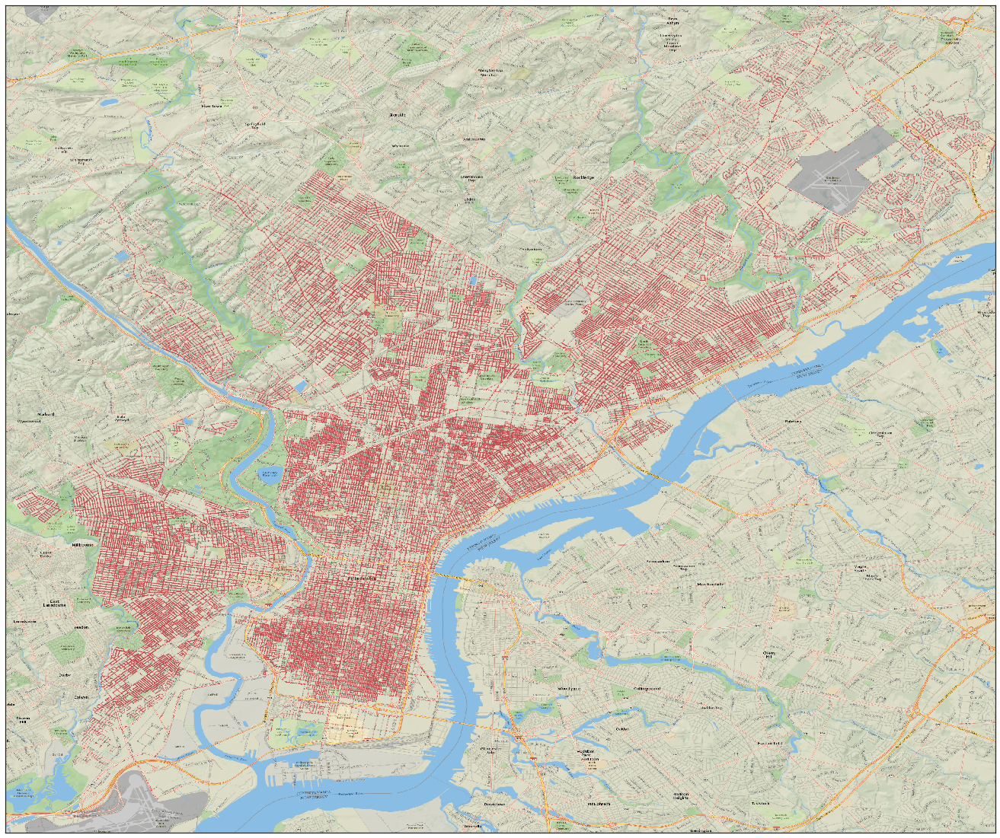

In [7]:
m = Basemap(projection='mill', llcrnrlat=Data.Lat.min(), urcrnrlat=Data.Lat.max(), 
            llcrnrlon=Data.Lon.min(), urcrnrlon=Data.Lon.max(), resolution='c', epsg=4269)
x,y = m(tuple(Data.Lon[(Data.Lon.isnull()==False)]),tuple(Data.Lat[(Data.Lat.isnull() == False)]))

plt.figure(figsize=(40,20))
m.arcgisimage(service="NatGeo_World_Map", xpixels=3000, verbose=True)
m.plot(x,y,'ro',markersize=1, alpha=0.3)

## The position of three main crimes happened in these years

http://server.arcgisonline.com/ArcGIS/rest/services/NatGeo_World_Map/MapServer/export?bbox=-75.277728,39.869991,-74.957504,40.137895&bboxSR=4269&imageSR=4269&size=3000,2509&dpi=96&format=png32&f=image


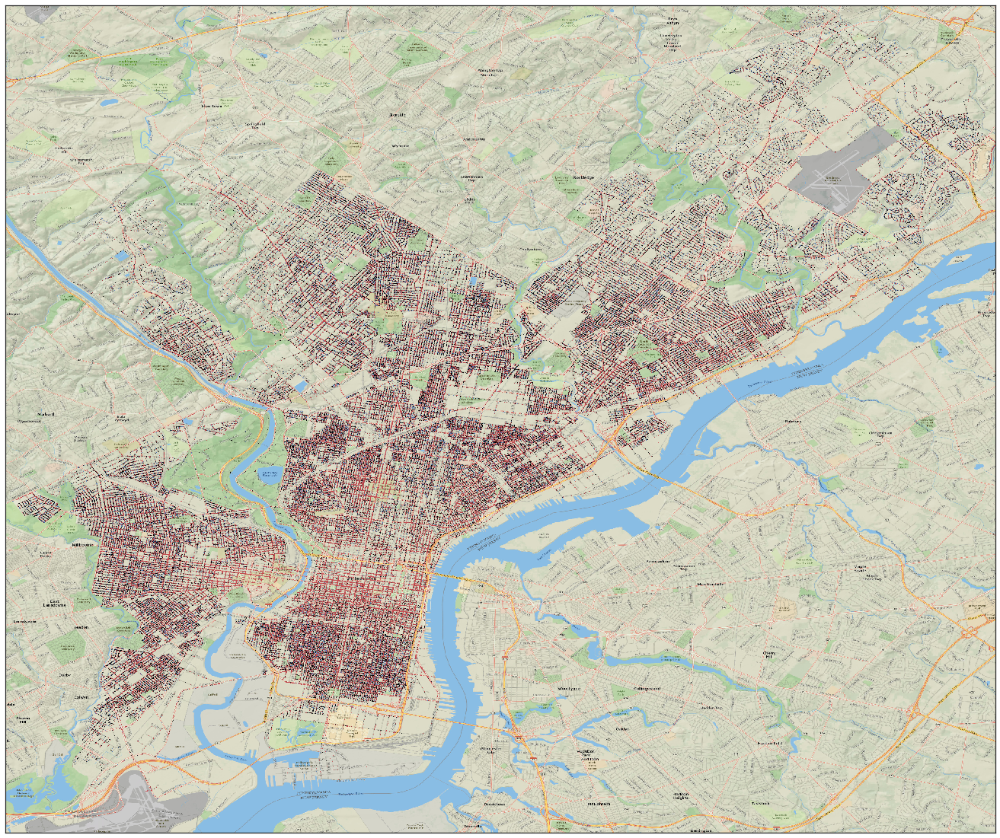

In [8]:
crimes=["Other Assaults","Vandalism/Criminal Mischief","Thefts"]
colors = ['b',[0,0,0],'r']

m = Basemap(projection='mill', llcrnrlat=Data.Lat.min(), urcrnrlat=Data.Lat.max(), 
            llcrnrlon=Data.Lon.min(), urcrnrlon=Data.Lon.max(), resolution='c', epsg=4269)
plt.figure(figsize=(40,20))
m.arcgisimage(service="NatGeo_World_Map", xpixels=3000, verbose=True)

for i in range(0,3):
    x, y = m(tuple(Data.Lon[(Data.Lon.isnull()==False) & (Data.Text_General_Code==crimes[i])]), \
         tuple(Data.Lat[(Data.Lat.isnull()== False) & (Data.Text_General_Code==crimes[i])]))
    m.plot(x,y,'ro',markersize=1, alpha=1,color = colors[i])


Firstly, I thought there is some connection between a particular crime behavouir and the position.
But from the map ,we cannot find the relationsip , the three crimes are geographically averaged. I guess maybe it is
because the dataset is too huge so that hide some relationships between them.

## The criminal behavior distribution  based on  Police_Districts and Dc_Dist

http://server.arcgisonline.com/ArcGIS/rest/services/NatGeo_World_Map/MapServer/export?bbox=-75.277728,39.869991,-74.957504,40.137895&bboxSR=4269&imageSR=4269&size=3000,2509&dpi=96&format=png32&f=image


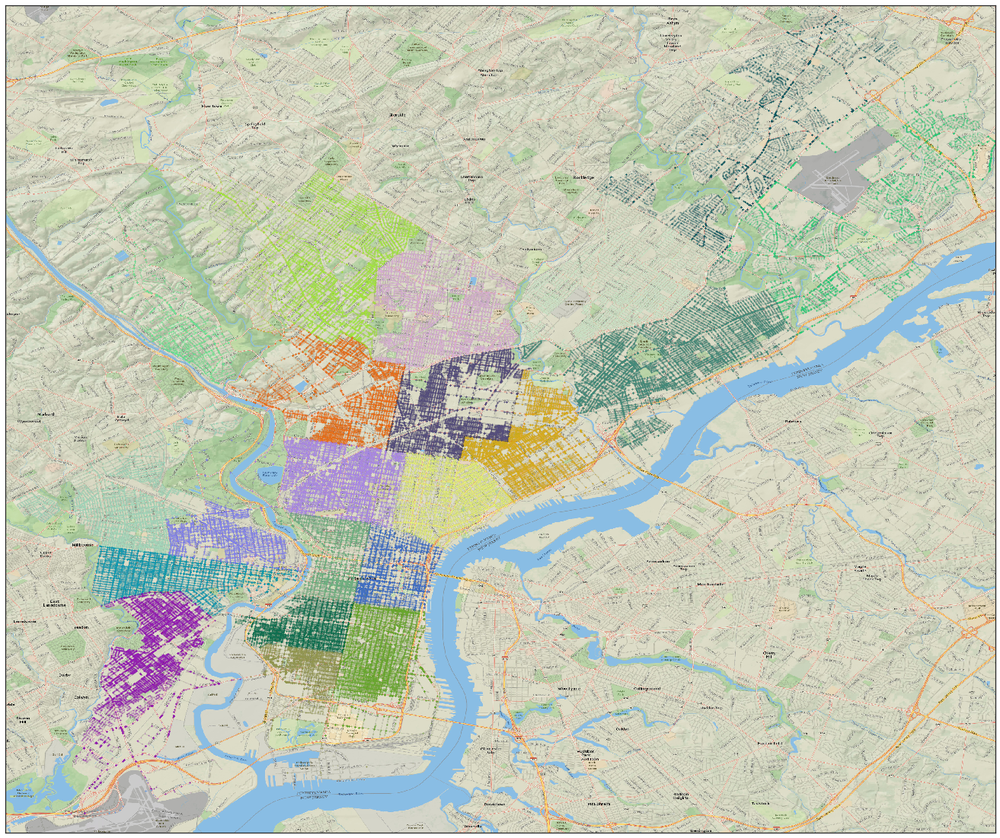

In [9]:
color = np.random.rand(Data.Police_Districts.unique().shape[0], 3)
plt.figure(figsize=(40,20))
m = Basemap(projection='mill', llcrnrlat=Data.Lat.min(), urcrnrlat=Data.Lat.max(), 
            llcrnrlon=Data.Lon.min(), urcrnrlon=Data.Lon.max(), resolution='c', epsg=4269)
m.arcgisimage(service="NatGeo_World_Map", xpixels=3000, verbose=True)
c = 0
for i in Data.Police_Districts.unique():
    x, y = m(tuple(Data.Lon[(Data.Lon.isnull()==False) & (Data.Police_Districts == i)]), \
         tuple(Data.Lat[(Data.Lat.isnull() == False) & (Data.Police_Districts == i)]))

    m.plot(x,y,'ro',markersize=1.5,alpha=0.1, color = color[c] )

    c += 1

http://server.arcgisonline.com/ArcGIS/rest/services/NatGeo_World_Map/MapServer/export?bbox=-75.277728,39.869991,-74.957504,40.137895&bboxSR=4269&imageSR=4269&size=3000,2509&dpi=96&format=png32&f=image


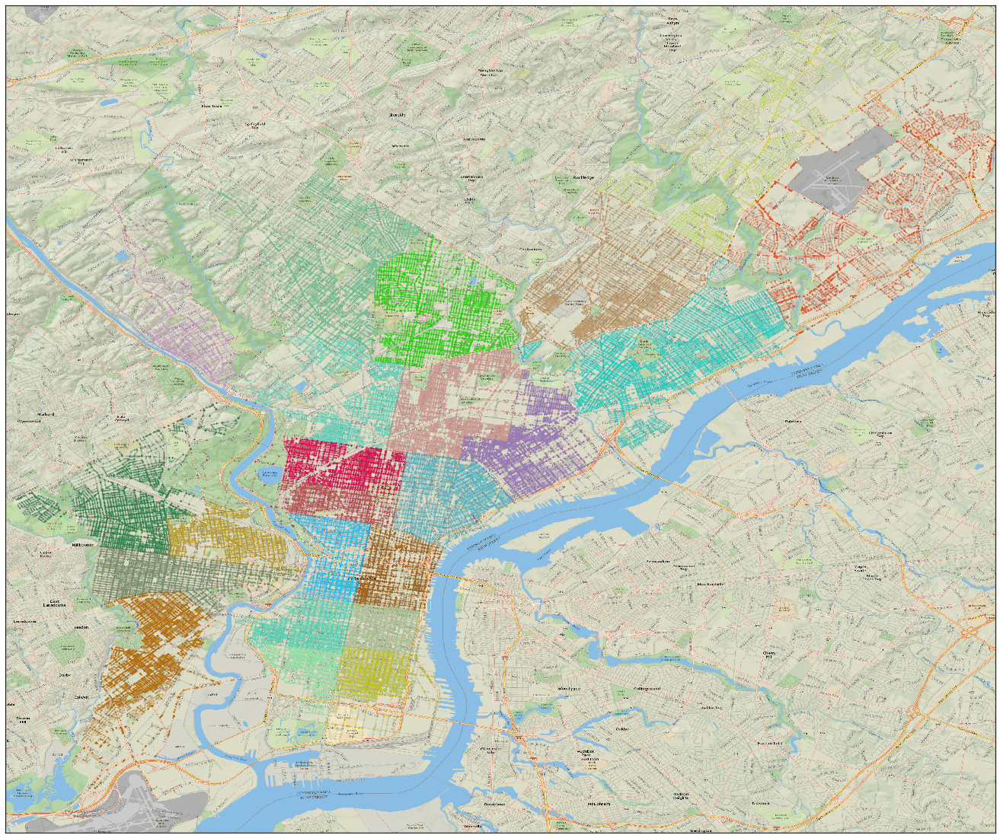

In [10]:
color = np.random.rand(Data.Dc_Dist.unique().shape[0], 3)
plt.figure(figsize=(40,20))

m = Basemap(projection='mill', llcrnrlat=Data.Lat.min(), urcrnrlat=Data.Lat.max(), 
            llcrnrlon=Data.Lon.min(), urcrnrlon=Data.Lon.max(), resolution='c', epsg=4269)
m.arcgisimage(service="NatGeo_World_Map", xpixels=3000, verbose=True)
c = 0
for i in Data.Dc_Dist.unique():
    x, y = m(tuple(Data.Lon[(Data.Lon.isnull()==False) & (Data.Dc_Dist == i)]), \
         tuple(Data.Lat[(Data.Lat.isnull() == False) & (Data.Dc_Dist == i)]))

    m.plot(x,y,'ro',markersize=1.5, alpha = 0.1, color = color[c] )
    c += 1

## A short vedio shows the crimes distribution in 1000 hours 

Basiclly, it shows the position pattern of crimes, I just want to have a try about making the short vedio.
I only show 1000 hours(around a month) from the first data in 2006,and the vedio is about 1 minnutes long.
If I want to show more hours or other period'pattern , I just need to change the variables.

http://server.arcgisonline.com/ArcGIS/rest/services/NatGeo_World_Map/MapServer/export?bbox=-75.277728,39.869991,-74.957504,40.137895&bboxSR=4269&imageSR=4269&size=3000,2509&dpi=96&format=png32&f=image


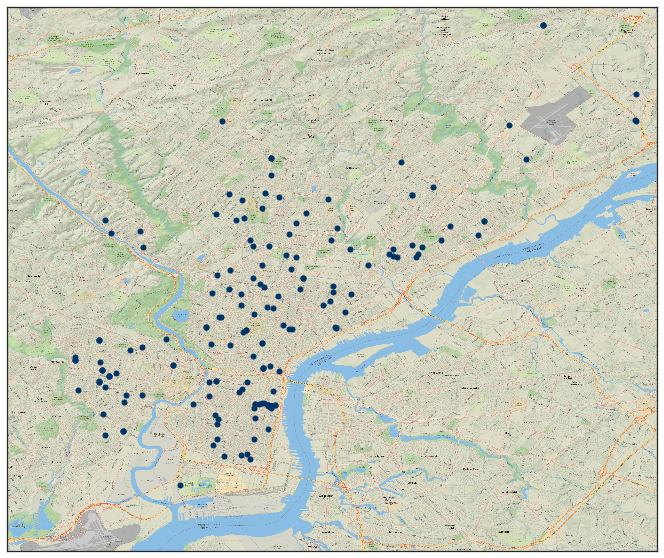

In [11]:

fig = plt.gcf()
plt.figure(figsize=(12,10))

m = Basemap(projection='mill', llcrnrlat=Data.Lat.min(), urcrnrlat=Data.Lat.max(),llcrnrlon=Data.Lon.min(), 
            urcrnrlon=Data.Lon.max(), resolution='c', epsg=4269)
x, y = m(Data.Lon[(Data.Lon.isnull()==False)],Data.Lat[(Data.Lat.isnull() == False)])

m.arcgisimage(service="NatGeo_World_Map", xpixels=3000, verbose=True)
a, b = m(Data.Lon.min(), Data.Lat.min())
graph = m.plot((a+1),(b+1), 'ro', markersize=6, alpha = 1.0)[0]
all_hour = Data.all_hour[(Data.Lon.isnull()==False) ] 


def animate(i):
    lons = x[(all_hour < i+4) & (all_hour >= i) ]
    lats = y[(all_hour < i+4) & (all_hour >= i) ]
    graph.set_data(lons, lats)
    if (i % 24 >=23) | (i % 24 <= 7):
        graph.set_color('#003366')
    else:
        graph.set_color('#D60000')
    return graph

anim = FuncAnimation(plt.gcf(), animate, repeat=True, frames=1000, interval=100)
from IPython.display import HTML
HTML(anim.to_html5_video())

## Conclusion

1.The total number of crimes has been declining year by year,with most crimes occurring in mid-year and less in winter.

2.The highest crime frequency belonged to “All Other Offenses”，“Thefts”，“Other Assaults”,
"Vandalism/Criminal Mischief",etc.

3.4.There is no direct relationship  between a certain kind of criminal activity and geographical position.
Crimes are geographically averaged.

5.The distribution of crimes based on DC_District and Police_District showed in above graphs.

6.The crimes distribution in 1000 hours showed in above vedio.